In [1]:
import pandas as pd

PROBLEMA -> La precipitación solo va del 1991 al 2018

64x64x77 pixels 1km resolution 77 variables

64x64x46




In [2]:
GBIF_DATA_PATH = 'Data\\'
file_name = 'assemblages_aggregated_by_grid_with_centroids.csv'
gbif_assemblages_1991_2020 = pd.read_csv(GBIF_DATA_PATH+file_name)

# Filter the gbif_assemblages DataFrame for years <= 2018
gbif_assemblages = gbif_assemblages_1991_2020[gbif_assemblages_1991_2020['year'] <= 2018]

gbif_assemblages

,grid_index,year,species,longitude,latitude
1,79231,2011,"['Angelica archangelica', 'Dactylorhiza majali...",5.172939,59.201189
2,79231,2012,"['Carex distans', 'Euphrasia foulaensis', 'Car...",5.172939,59.201189
3,79231,2014,"['Lysimachia europaea', 'Ficaria verna', 'Junc...",5.172939,59.201189
4,79231,2015,"['Tripolium pannonicum', 'Centaurium littorale...",5.172939,59.201189
5,79231,2016,"['Lysimachia europaea', 'Lythrum salicaria', '...",5.172939,59.201189
...,...,...,...,...,...
71740,1818627,2012,"['Avenella flexuosa', 'Lathyrus japonicus', 'H...",30.835603,69.774990
71741,1818627,2017,"['Luzula spicata', 'Antennaria dioica', 'Cochl...",30.835603,69.774990
71742,1820117,1994,"['Honckenya peploides', 'Alnus incana', 'Epilo...",30.847255,69.755439
71743,1821608,1994,"['Taraxacum spectabile', 'Astragalus norvegicu...",30.865522,69.744514


excluding the years 2019 and 2020 filters out 10.000 samples!!!!!

We will have to complement the preciptation of these years with some other model

### Function for reading Chelsa variables patch

In [3]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

In [4]:
# Load the NetCDF file
def read_netcdf(file_path,latitude,longitude,grid,location,variable = None):
    data = xr.open_dataset(file_path)
    
    # Step 1: Find the indices of the closest grid point
    lat_idx = np.argmin(np.abs(data['lat'].values - latitude))
    lon_idx = np.argmin(np.abs(data['lon'].values - longitude))
    
    # Step 2: Select all months of the year
    #precipitation= data.sel(**{"time": slice(1, 12)})

    # Extract variable name (it is always the last variable)
    variable = list(data.data_vars.keys())[-1]
    # Step 3: Extract a 10x10 grid centered around Bergen
    patch = data[variable].isel(
        lat=slice(lat_idx - grid, lat_idx + grid),
        lon=slice(lon_idx - grid, lon_idx + grid)
    )
    
    # Step 4: Calculate the mean precipitation across all months
    #mean_patch = patch.mean(dim="time")
    
    # Step 5: Plot with Cartopy for map context
    plt.figure(figsize=(10, 8))
    ax = plt.axes(projection=ccrs.PlateCarree())  # PlateCarree assumes latitude/longitude
    
    # Plot the precipitation data
    # mean_patch.plot(ax=ax, cmap="Blues", transform=ccrs.PlateCarree(), add_colorbar=True)
    patch.plot(ax=ax, cmap="Blues", transform=ccrs.PlateCarree(), add_colorbar=True)
    
    # Add map features
    ax.add_feature(cfeature.BORDERS, linestyle=':', edgecolor='black')  # Country borders
    ax.add_feature(cfeature.COASTLINE, edgecolor='black')               # Coastline
    # ax.set_extent([mean_patch.lon.min(), mean_patch.lon.max(), mean_patch.lat.min(), mean_patch.lat.max()])
    ax.set_extent([patch.lon.min(), patch.lon.max(), patch.lat.min(), patch.lat.max()])

    
    # Add city marker for Bergen
    plt.scatter(longitude, latitude, color="red", label=location, transform=ccrs.PlateCarree())
    plt.legend()
    
    # Title and labels
    plt.title(f"{variable} in {location}, (10x10 grid)")
    plt.show()

    return patch

In [5]:
# Load the NetCDF file

def load_NetCDF_file(path):
    data = xr.open_dataset(path)
    return data

### Reading altitude

In [6]:
path_altitude = r"C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc"
data_altitude = load_NetCDF_file(path_altitude)
data_altitude

<xarray.Dataset> Size: 4GB
Dimensions:      (lat: 20880, lon: 43200)
Coordinates:
  * lat          (lat) float64 167kB -90.0 -89.99 -89.98 ... 83.98 83.99 84.0
  * lon          (lon) float64 346kB -180.0 -180.0 -180.0 ... 180.0 180.0 180.0
Data variables:
    crs          |S1 1B ...
    dem_latlong  (lat, lon) float32 4GB ...
Attributes:
    Conventions:  CF-1.5
    GDAL:         GDAL 3.0.4, released 2020/01/28
    history:      Wed Oct  6 17:40:35 2021: ncatted -a missing_value,dem_latl...
    NCO:          4.6.8

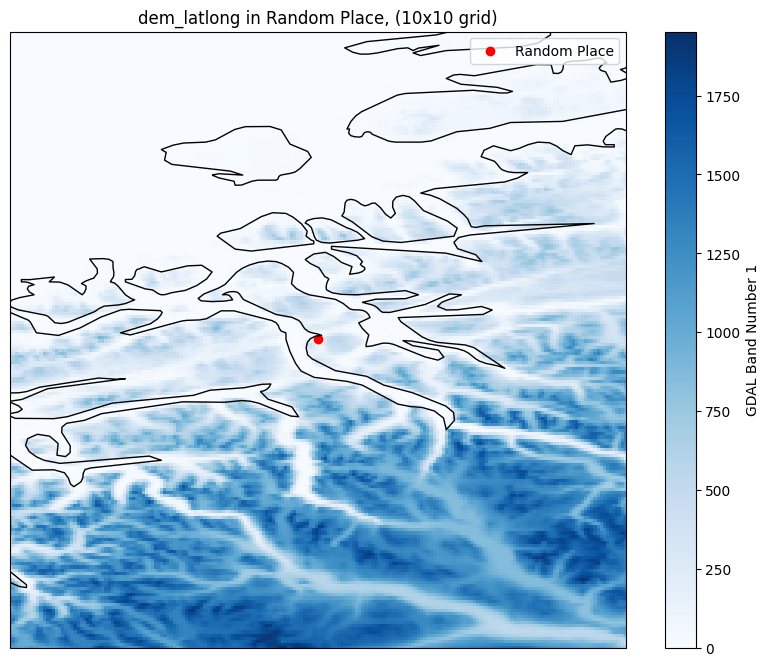

In [7]:

altitude_test = read_netcdf(file_path = path_altitude, #path_prsd,
            latitude = 62.9,
            longitude = 8.2,
            # variable = 'pr',
            grid = 100,
            location = 'Random Place')

#### Usage example

In [8]:
#!pip install netcdf4 h5netcdf

In [9]:
path_prsd = "CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/prsd/CHELSA_EUR11_obs_prsd_1991_V.2.1.nc"
data_example = load_NetCDF_file(path_prsd)
data_example

<xarray.Dataset> Size: 320MB
Dimensions:    (time: 1, bnds: 2, lon: 13147, lat: 6077)
Coordinates:
  * time       (time) datetime64[ns] 8B 1991-07-02
  * lon        (lon) float64 105kB -44.64 -44.63 -44.62 ... 64.9 64.9 64.91
  * lat        (lat) float64 49kB 21.97 21.98 21.99 22.0 ... 72.59 72.6 72.6
Dimensions without coordinates: bnds
Data variables:
    time_bnds  (time, bnds) datetime64[ns] 16B ...
    crs        int32 4B ...
    pr         (time, lat, lon) float32 320MB ...
Attributes:
    CDI:                 Climate Data Interface version 1.9.9rc1 (https://mpi...
    Conventions:         CF-1.5
    history:             Mon Jan 30 17:44:41 2023: cdo -b 32 timstd /storage/...
    institution:         Swiss Federal Institute for Forest\
    GDAL_AREA_OR_POINT:  Area
    GDAL:                GDAL 2.2.3, released 2017/11/20
    title:               CHELSA V2.1
    project:             CHELSA - Climatologies at high resolution for the ea...
    contact:             Dirk N. Karger\
    references:          Karger DN. et al. Climatologies at high resolution f...
    doi:                 doi: 10.16904/envidat.228.v2.1
    CDO:                 Climate Data Operators version 1.9.9rc1 (https://mpi...

In [10]:
data_example['pr']
type(data_example.data_vars)
for i in data_example.data_vars:
    print(i)

time_bnds
crs
pr


In [11]:
list(data_example.data_vars.keys())[-1]

'pr'

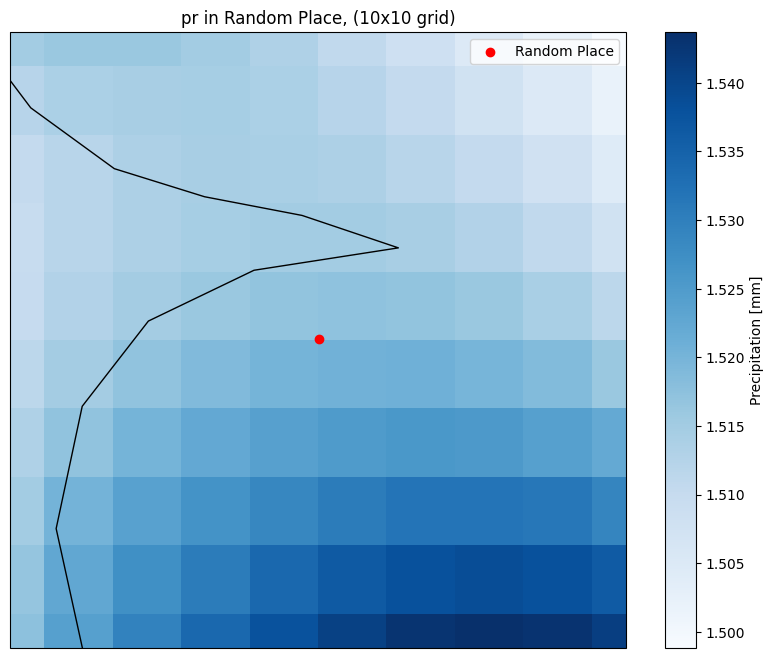

In [12]:
path_bio15d = "CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio15d/CHELSA_EUR11_obs_bio15d_2000_V.2.1.nc"

bio15d_2000 = read_netcdf(file_path = path_bio15d, #path_prsd,
            latitude = 62.9,
            longitude = 8.2,
            # variable = 'pr',
            grid = 5,
            location = 'Random Place')


In [13]:
bio15d_2000

<xarray.DataArray 'pr' (time: 1, lat: 10, lon: 10)> Size: 400B
[100 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 8B 2000-07-01
  * lon      (lon) float64 80B 8.162 8.171 8.179 8.187 ... 8.221 8.229 8.237
  * lat      (lat) float64 80B 62.86 62.87 62.88 62.89 ... 62.92 62.93 62.94
Attributes:
    standard_name:  precipitation
    long_name:      Precipitation
    units:          mm
    grid_mapping:   crs

### Reading All variables per Sample

In [14]:
import os

CHELSA_path = 'CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1'
# Scan the directory and get
# an iterator of os.DirEntry objects
# corresponding to entries in it
# using os.scandir() method
obj = os.scandir(CHELSA_path)

# List all files and directories in the specified path
print("Files and Directories in '% s':" % CHELSA_path)
variables = []
for entry in obj:
    if entry.is_dir():
        #print(entry.name)
        variables.append(entry.name)
variables

Files and Directories in 'CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1':


['bio01d',
 'bio04d',
 'bio12d',
 'bio15d',
 'cdd',
 'fd',
 'gdd5',
 'prsd',
 'scd',
 'swe']

In [15]:

for variable in variables:
    path = f"CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/{variable}/CHELSA_EUR11_obs_{variable}_1991_V.2.1.nc"
    data_climatic_variable = load_NetCDF_file(path)
    print(f"The data structure for {variable} is: \n")
    print(data_climatic_variable)
    print('-------------------------------------------------------------------------------------------')

The data structure for bio01d is: 

<xarray.Dataset> Size: 320MB
Dimensions:    (time: 1, bnds: 2, lon: 13147, lat: 6077)
Coordinates:
  * time       (time) datetime64[ns] 8B 1991-07-02
  * lon        (lon) float64 105kB -44.64 -44.63 -44.62 ... 64.9 64.9 64.91
  * lat        (lat) float64 49kB 21.97 21.98 21.99 22.0 ... 72.59 72.6 72.6
Dimensions without coordinates: bnds
Data variables:
    time_bnds  (time, bnds) datetime64[ns] 16B ...
    crs        int32 4B ...
    tas        (time, lat, lon) float32 320MB ...
Attributes: (12/13)
    CDI:                 Climate Data Interface version 1.9.9rc1 (https://mpi...
    Conventions:         CF-1.5
    history:             Wed Feb 08 08:57:18 2023: cdo timmean /storage/karge...
    institution:         Swiss Federal Institute for Forest\
    GDAL_AREA_OR_POINT:  Area
    GDAL:                GDAL 2.2.3, released 2017/11/20
    ...                  ...
    project:             CHELSA - Climatologies at high resolution for the ea...
    con

### Plotting 1 sample

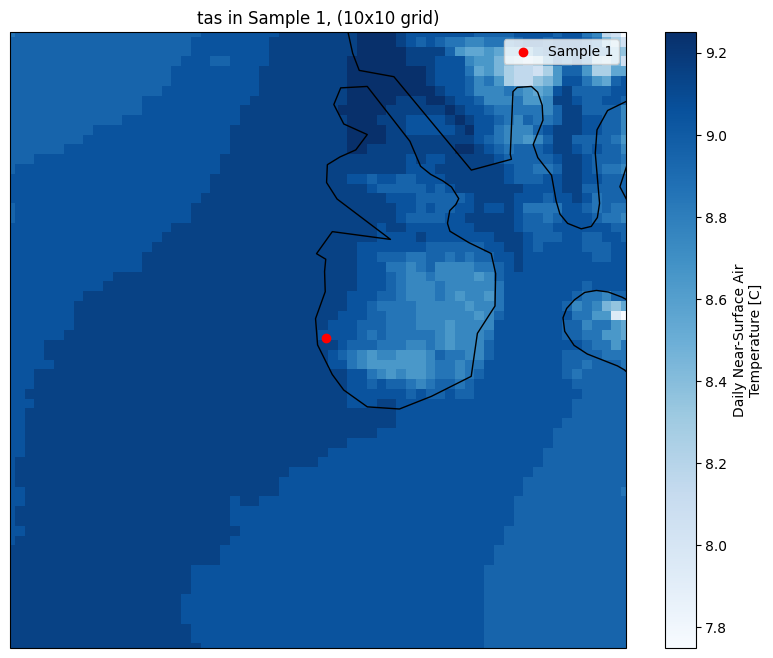

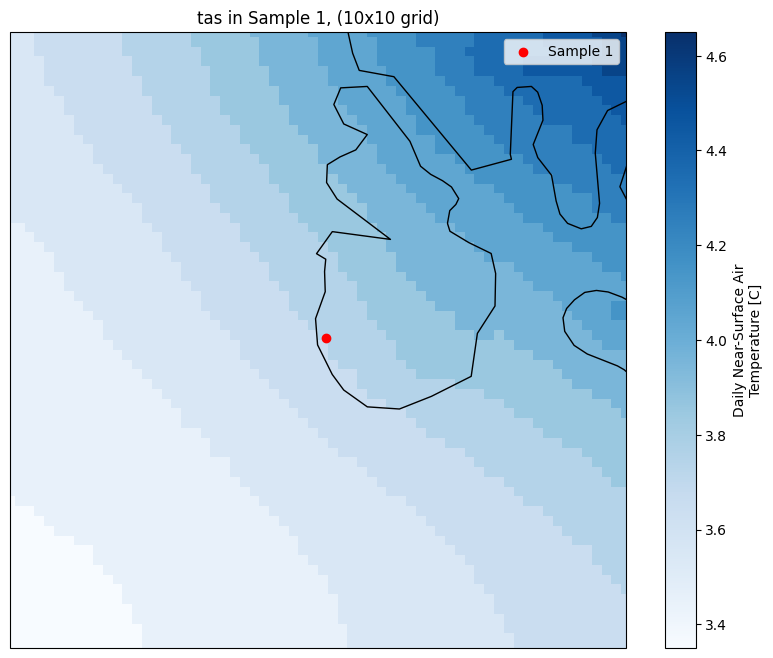

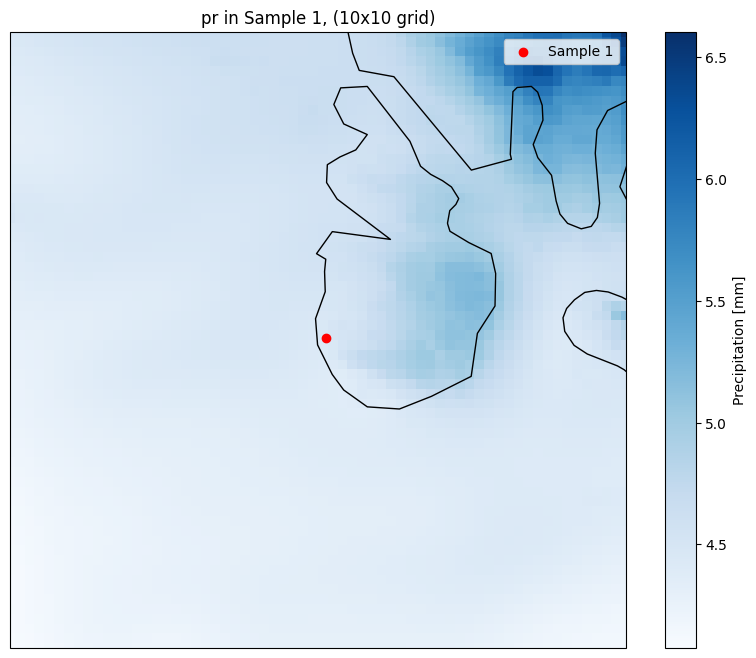

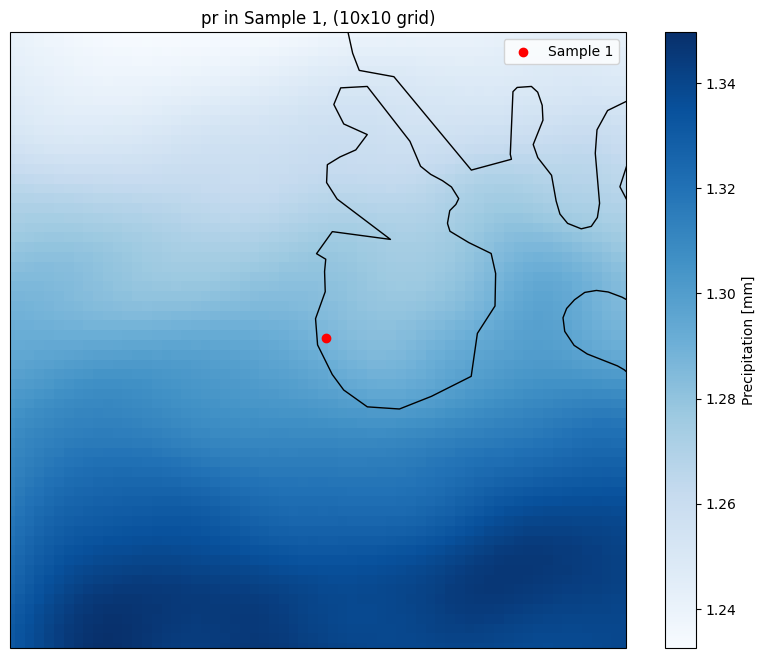

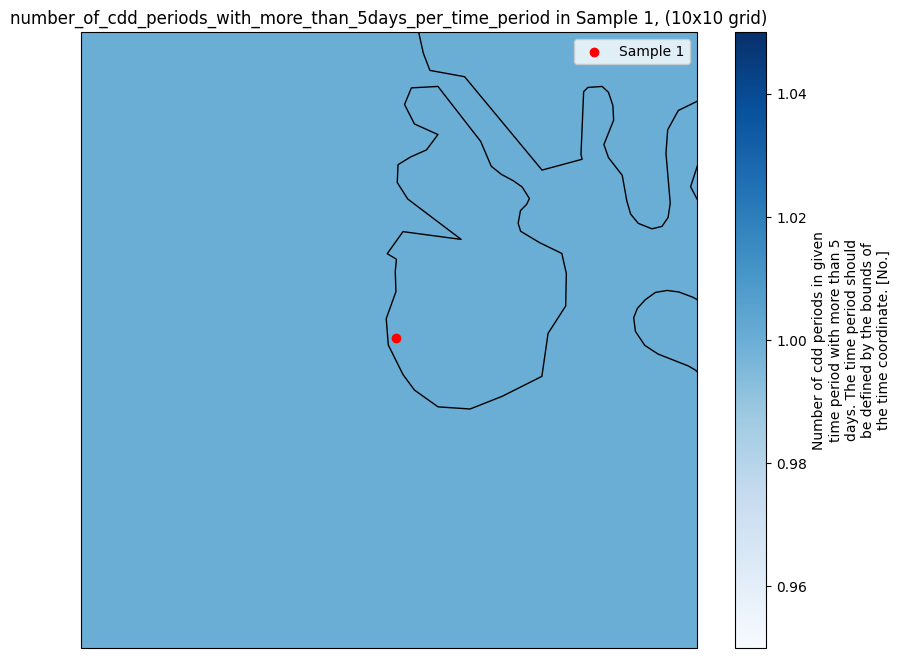

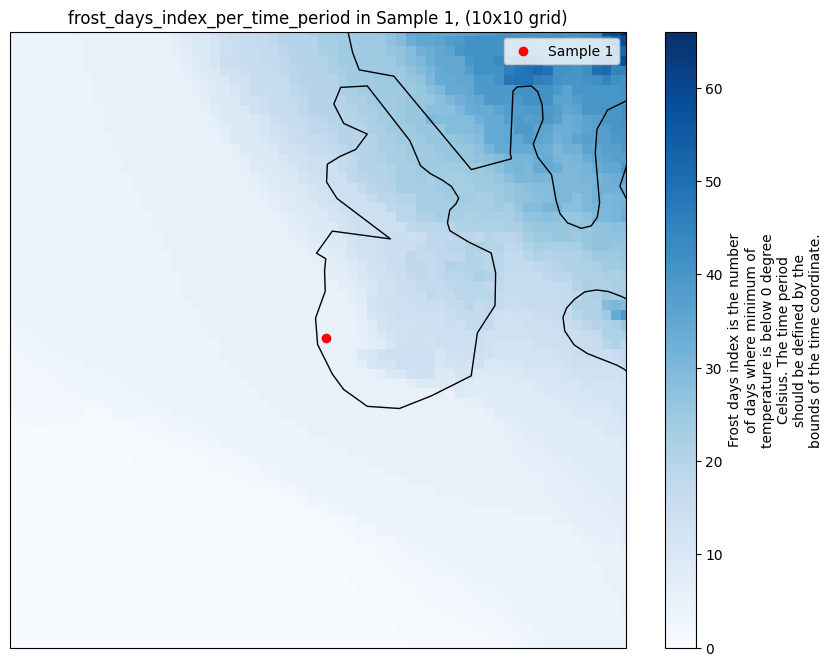

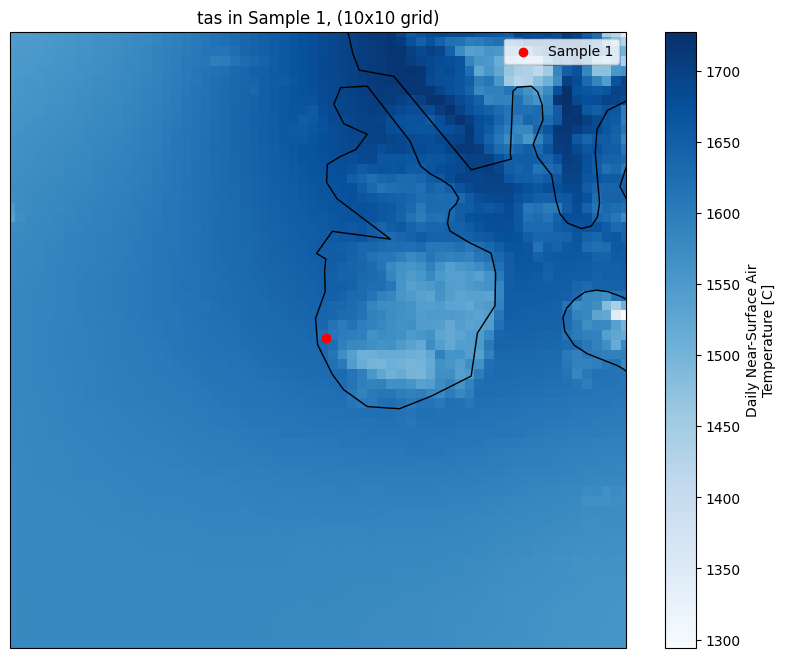

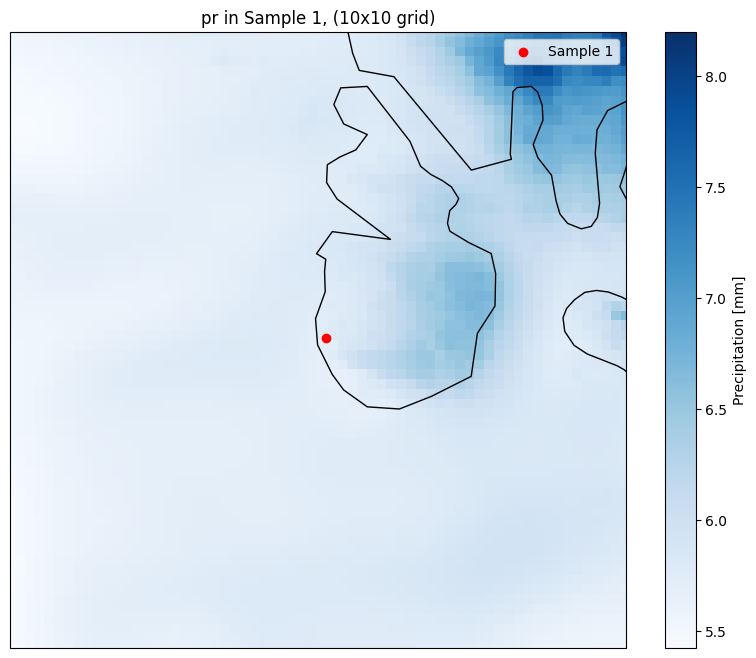

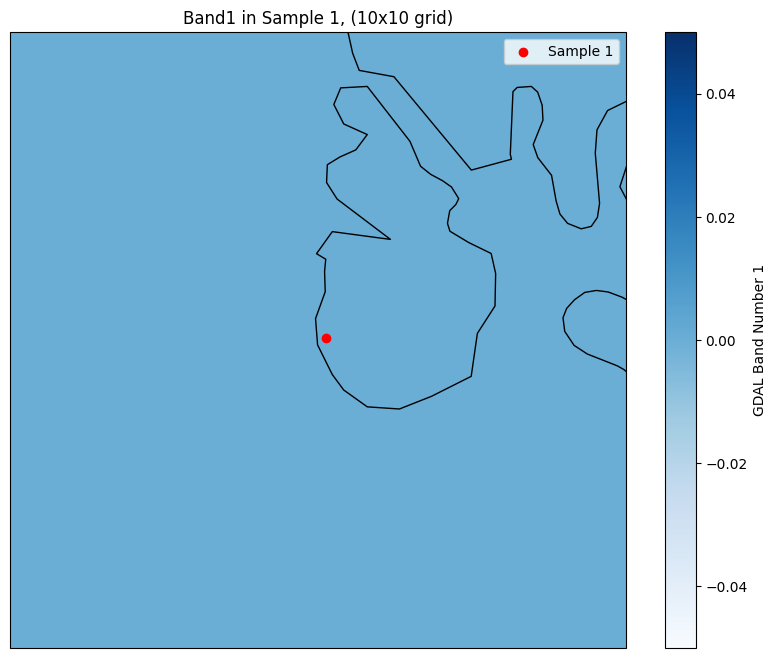

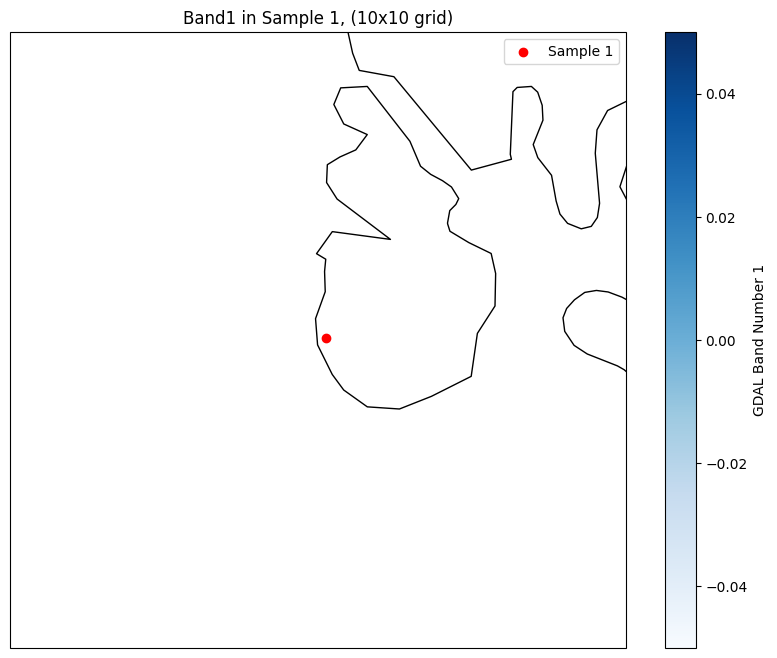

In [16]:
# hay que hacer que de cada sample nos saque las 10 variables climaticas para ese año del fly
# toca inspeccionar manualmente el formato de datos de cada variable y ver si la función sirve para todas
year = '2000'
i = 1

for variable in variables:
    # Define figure and grid layout
    
    dataset = read_netcdf(file_path = CHELSA_path+'/'+variable+f'/CHELSA_EUR11_obs_{variable}_{year}_V.2.1.nc',
                latitude = gbif_assemblages.iloc[0].latitude, #lat of the 1st sample of the dataframe
                longitude = gbif_assemblages.iloc[0].longitude, #lon of the 1st sample of the dataframe
                grid = 32, # grid size (1km scale)
                location = f'Sample {i}') # Title (sample number)


    

### Plotting many samples

PROBLEMA -> La precipitación solo va del 1991 al 2018

In [17]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import xarray as xr
import numpy as np

# Function to read and return a NetCDF plot
def read_netcdf_gpt(file_path, latitude, longitude, grid, grid_index, year, sample_number, ax):
    data = xr.open_dataset(file_path)

    # Extract variable name (it is always the last variable)
    variable = list(data.data_vars.keys())[-1]

    # Find the closest grid point
    lat_idx = np.argmin(np.abs(data['lat'].values - latitude))
    lon_idx = np.argmin(np.abs(data['lon'].values - longitude))
    
    # Extract a 10×10 grid
    patch = data[variable].isel(
        lat=slice(lat_idx - grid, lat_idx + grid),
        lon=slice(lon_idx - grid, lon_idx + grid)
    ).fillna(0)
    
    # Set title with all requested info
    #ax.set_title(f"{variable} - Sample {sample_number} - Grid {grid_index} - Year {year}", fontsize=10)
    ax.set_extent([patch.lon.min(), patch.lon.max(), patch.lat.min(), patch.lat.max()])
    
    # Plot data
    patch.plot(ax=ax, cmap="Blues", transform=ccrs.PlateCarree(), add_colorbar=False)

    # Add map features
    ax.add_feature(cfeature.BORDERS, linestyle=":", edgecolor="black")  # Country borders
    ax.add_feature(cfeature.COASTLINE, edgecolor="black")               # Coastline
    
    # Mark sample location
    ax.scatter(longitude, latitude, color="red", label=f"Sample {sample_number}", transform=ccrs.PlateCarree())
    ax.legend()




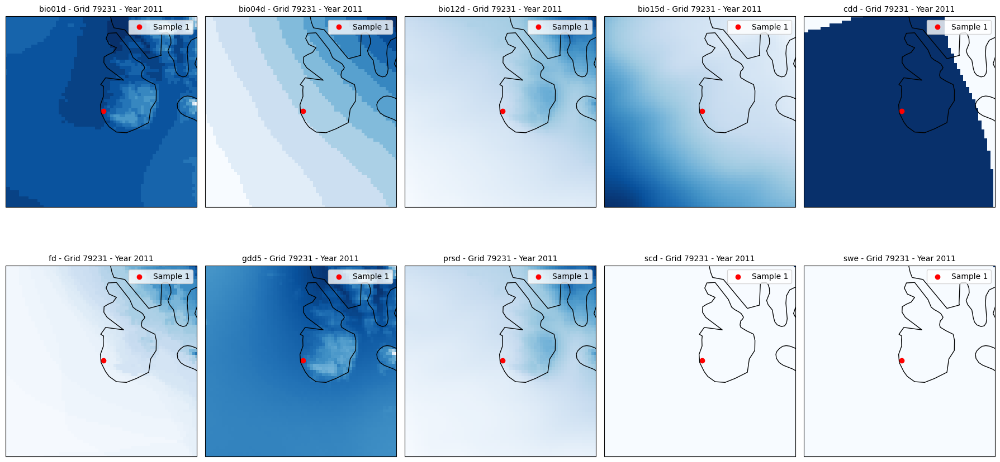

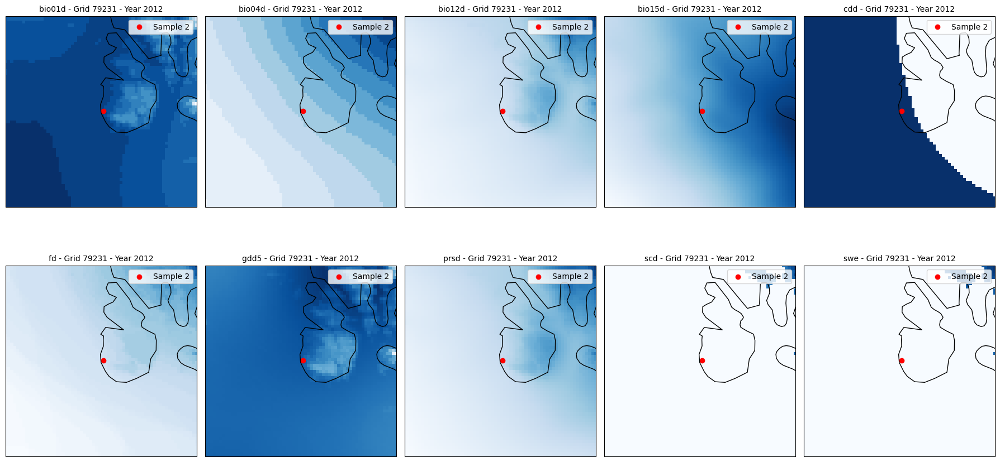

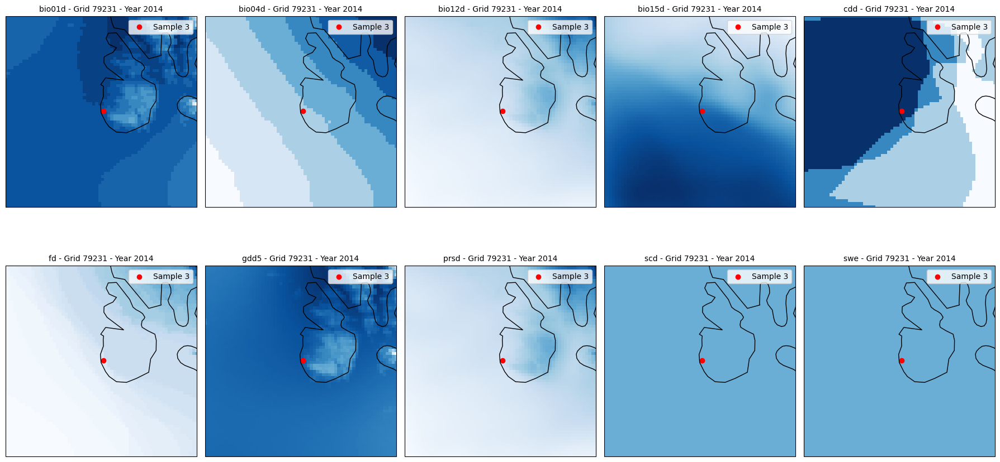

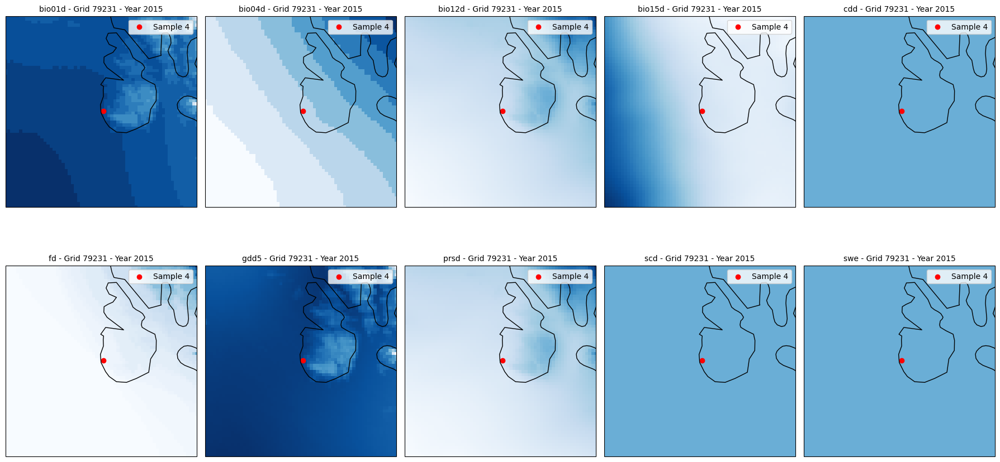

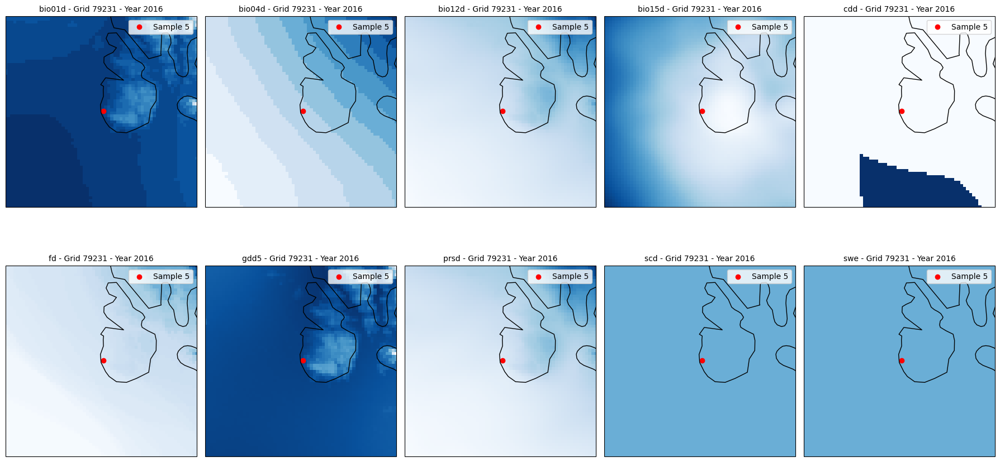

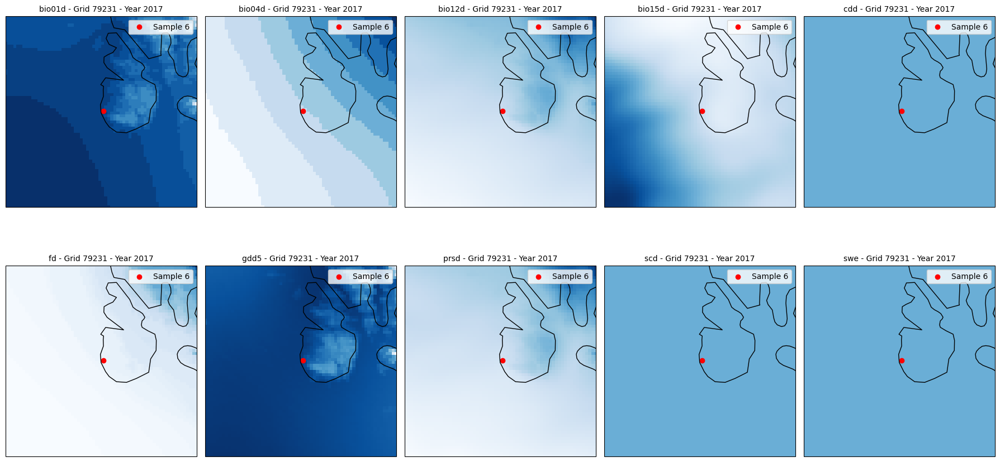

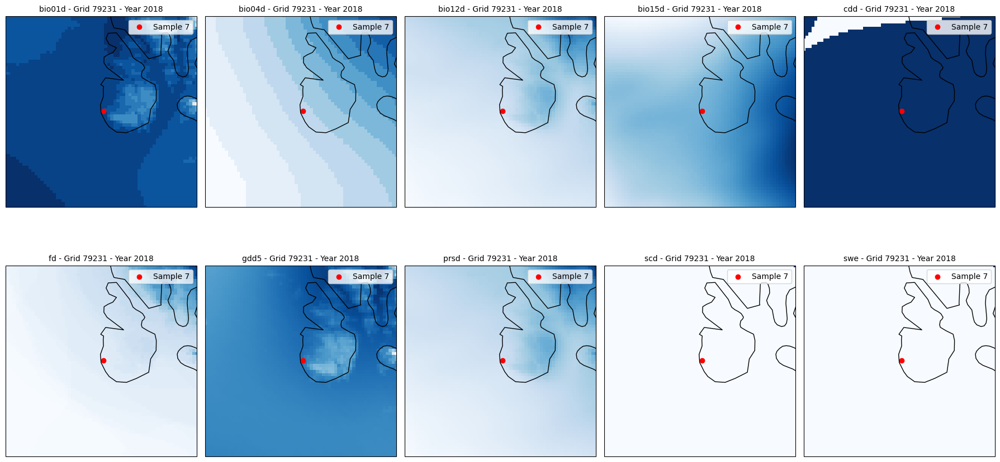

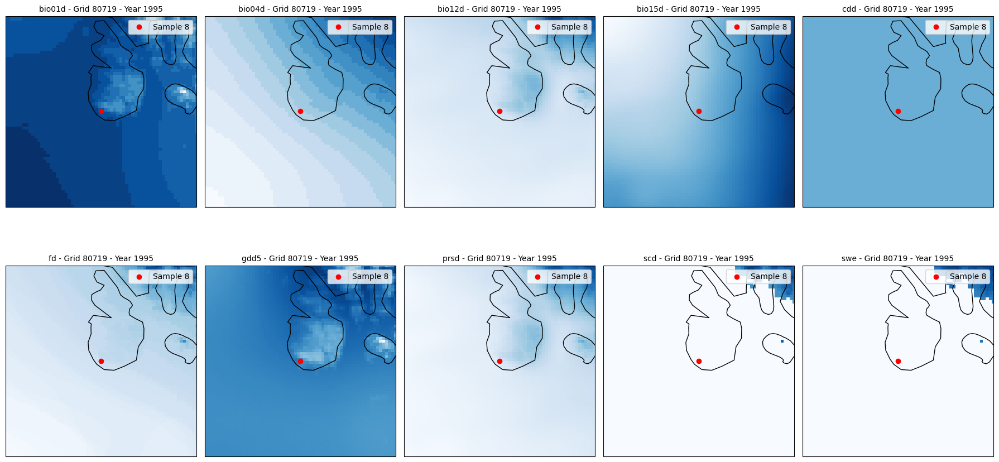

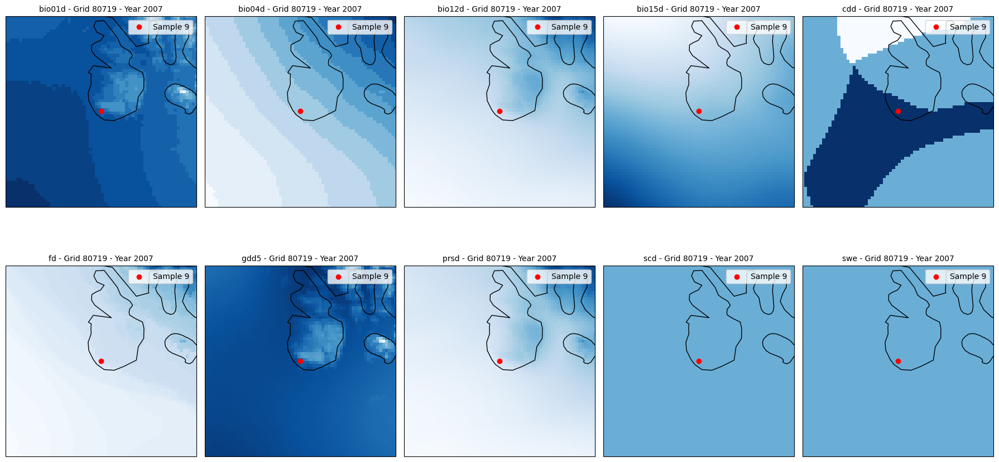

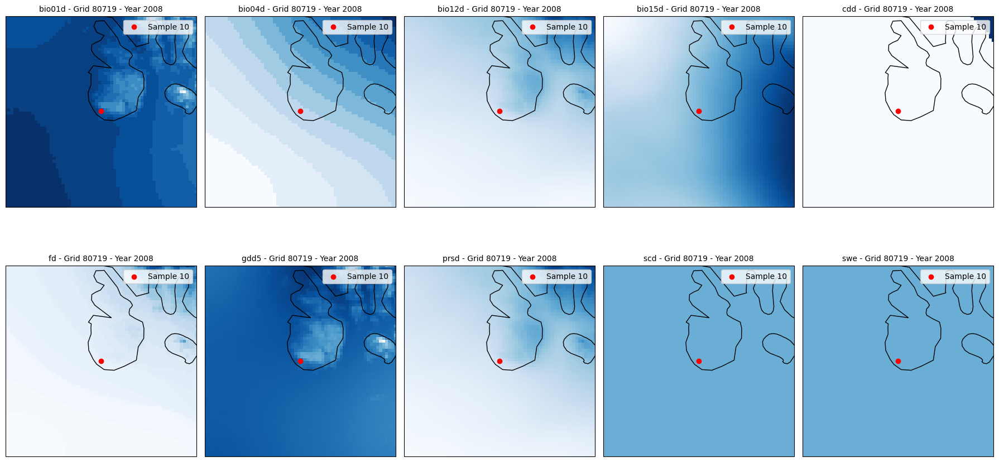

In [18]:
# Loop through each sample in gbif_assemblages
#year = "2000"
for i, sample in enumerate(gbif_assemblages.head(10).itertuples()):  #change head to adjust the nº of samples
    latitude = sample.latitude
    longitude = sample.longitude
    grid_index = sample.grid_index  # Extract grid index from dataframe
    year = sample.year
    # Create figure and 2x5 grid layout
    fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(18, 10), subplot_kw={"projection": ccrs.PlateCarree()})
    axes = axes.flatten()  # Flatten to iterate easily

    for idx, variable in enumerate(variables):
        if idx >= len(axes):  # Avoid out-of-bounds errors
            break

        # Define file path for the current variable
        file_path = f"{CHELSA_path}/{variable}/CHELSA_EUR11_obs_{variable}_{year}_V.2.1.nc"
        
        # Call `read_netcdf_gpt` and plot on the corresponding subplot
        read_netcdf_gpt(file_path, latitude, longitude, grid=32, grid_index=grid_index, year=year, 
                        sample_number=i+1, ax=axes[idx])
        axes[idx].set_title(f"{variable} - Grid {grid_index} - Year {year}", fontsize=10)

    # Hide unused subplots
    for j in range(idx + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()

### Stacking patches (10 variables stacked in 10 channels)

Applyin [MinMaxScaling](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.MinMaxScaler.html) for each variable

In [19]:
import xarray as xr
import numpy as np
from sklearn.preprocessing import MinMaxScaler

def read_netcdf_stack(file_paths, latitude, longitude, grid):
    patches = []
    scaler = MinMaxScaler(feature_range=(0, 1))  # Define the scaler

    for file_path in file_paths:
        data = xr.open_dataset(file_path)
        variable = list(data.data_vars.keys())[-1]

        lat_idx = np.argmin(np.abs(data['lat'].values - latitude))
        lon_idx = np.argmin(np.abs(data['lon'].values - longitude))

        patch = data[variable].isel(
            lat=slice(lat_idx - grid, lat_idx + grid),
            lon=slice(lon_idx - grid, lon_idx + grid)
        ).fillna(0).values  # Convert to NumPy

        print(f"Shape of patch for {file_path} {variable}: {patch.shape}")

        # Remove extra dimension if necessary
        if patch.shape[0] == 1:
            patch = patch[0]

        # Reshape for MinMax scaling (flatten to 2D)
        patch_reshaped = patch.reshape(-1, 1)  # Flatten but keep 1 feature

        # Apply MinMax Scaling
        patch_scaled = scaler.fit_transform(patch_reshaped)

        # Reshape back to original (grid*2, grid*2)
        patch_scaled = patch_scaled.reshape(patch.shape)

        patches.append(patch_scaled)  # Add scaled patch

    # Stack along last axis (channels dimension)
    stacked_patches = np.stack(patches, axis=-1)

    return stacked_patches



In [20]:

# Example Usage:
# Define the file paths for each variable (you need to have the full paths for each variable)
path_altitude = r"C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc"

variables = ['gdd5', 'prsd', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd']
file_paths = [f"CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/{var}/CHELSA_EUR11_obs_{var}_2000_V.2.1.nc" for var in variables]
file_paths.append(path_altitude)
latitude = 62.9,
longitude = 8.2,
grid_size = 32 # 10x10 grid bc we substract 5 from lat and 5 from lon

# Call the function to get the stacked patches
stacked_patches = read_netcdf_stack(file_paths, latitude, longitude, grid_size)

# Now stacked_patches is a 3D numpy array with shape (10, 10, 10), representing a 10x10 grid with 10 channels

Shape of patch for CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/gdd5/CHELSA_EUR11_obs_gdd5_2000_V.2.1.nc tas: (1, 64, 64)
Shape of patch for CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/prsd/CHELSA_EUR11_obs_prsd_2000_V.2.1.nc pr: (1, 64, 64)
Shape of patch for CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio12d/CHELSA_EUR11_obs_bio12d_2000_V.2.1.nc pr: (1, 64, 64)
Shape of patch for CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/swe/CHELSA_EUR11_obs_swe_2000_V.2.1.nc Band1: (64, 64)
Shape of patch for CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio01d/CHELSA_EUR11_obs_bio01d_2000_V.2.1.nc tas: (1, 64, 64)
Shape of patch for CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio04d/CHELSA_EUR11_obs_bio04d_2000_V.2.1.nc tas: (1, 64, 64)
Shape of patch for CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/cdd/CHELSA_EUR11_obs_cdd_2000_V.2.1.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 64, 64)
Shape of patch for CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.

In [21]:
len(stacked_patches),len(stacked_patches[0]),len(stacked_patches[0][0])

(64, 64, 11)

In [22]:
stacked_patches.shape

(64, 64, 11)

### Stacking for all samples!!!!!!!!!!!!!!!!!!

In [23]:
gbif_assemblages.head()

,grid_index,year,species,longitude,latitude
1,79231,2011,"['Angelica archangelica', 'Dactylorhiza majali...",5.172939,59.201189
2,79231,2012,"['Carex distans', 'Euphrasia foulaensis', 'Car...",5.172939,59.201189
3,79231,2014,"['Lysimachia europaea', 'Ficaria verna', 'Junc...",5.172939,59.201189
4,79231,2015,"['Tripolium pannonicum', 'Centaurium littorale...",5.172939,59.201189
5,79231,2016,"['Lysimachia europaea', 'Lythrum salicaria', '...",5.172939,59.201189


In [24]:
# Define the file paths for each variable (you need to have the full paths for each variable)
path_altitude = r"C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc"

variables =['gdd5', 'prsd', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd'] # 'swe', we have removed it bc it has Nan values in many cases

stacked_patches_list = []
x = 100
for i in range(x): # gbif_assemblages.shape[0]
    sample =  gbif_assemblages.iloc[i]
    file_paths = [f"CHELSA\\1991-2020\\chelsav2\\EUR11\\obs\\annual\\V2.1\\{var}\\CHELSA_EUR11_obs_{var}_{sample.year}_V.2.1.nc" for var in variables]
    file_paths.append(path_altitude)
    
    # Call the function to get the stacked patches
    stacked_patches = read_netcdf_stack(file_paths = file_paths, 
                                        latitude = sample.latitude, 
                                        longitude = sample.longitude, 
                                        grid = 16) # better to use multiples of 64
    
    stacked_patches_list.append(stacked_patches)

    print(f'Sample {i} correctly stacked and added to the list')
    print('\n\n')

Shape of patch for CHELSA\1991-2020\chelsav2\EUR11\obs\annual\V2.1\gdd5\CHELSA_EUR11_obs_gdd5_2011_V.2.1.nc tas: (1, 32, 32)
Shape of patch for CHELSA\1991-2020\chelsav2\EUR11\obs\annual\V2.1\prsd\CHELSA_EUR11_obs_prsd_2011_V.2.1.nc pr: (1, 32, 32)
Shape of patch for CHELSA\1991-2020\chelsav2\EUR11\obs\annual\V2.1\bio12d\CHELSA_EUR11_obs_bio12d_2011_V.2.1.nc pr: (1, 32, 32)
Shape of patch for CHELSA\1991-2020\chelsav2\EUR11\obs\annual\V2.1\swe\CHELSA_EUR11_obs_swe_2011_V.2.1.nc Band1: (32, 32)
Shape of patch for CHELSA\1991-2020\chelsav2\EUR11\obs\annual\V2.1\bio01d\CHELSA_EUR11_obs_bio01d_2011_V.2.1.nc tas: (1, 32, 32)
Shape of patch for CHELSA\1991-2020\chelsav2\EUR11\obs\annual\V2.1\bio04d\CHELSA_EUR11_obs_bio04d_2011_V.2.1.nc tas: (1, 32, 32)
Shape of patch for CHELSA\1991-2020\chelsav2\EUR11\obs\annual\V2.1\cdd\CHELSA_EUR11_obs_cdd_2011_V.2.1.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for CHELSA\1991-2020\chelsav2\EUR11\obs\annual\V2.

In [25]:
file_paths

['CHELSA\\1991-2020\\chelsav2\\EUR11\\obs\\annual\\V2.1\\gdd5\\CHELSA_EUR11_obs_gdd5_2016_V.2.1.nc',
 'CHELSA\\1991-2020\\chelsav2\\EUR11\\obs\\annual\\V2.1\\prsd\\CHELSA_EUR11_obs_prsd_2016_V.2.1.nc',
 'CHELSA\\1991-2020\\chelsav2\\EUR11\\obs\\annual\\V2.1\\bio12d\\CHELSA_EUR11_obs_bio12d_2016_V.2.1.nc',
 'CHELSA\\1991-2020\\chelsav2\\EUR11\\obs\\annual\\V2.1\\swe\\CHELSA_EUR11_obs_swe_2016_V.2.1.nc',
 'CHELSA\\1991-2020\\chelsav2\\EUR11\\obs\\annual\\V2.1\\bio01d\\CHELSA_EUR11_obs_bio01d_2016_V.2.1.nc',
 'CHELSA\\1991-2020\\chelsav2\\EUR11\\obs\\annual\\V2.1\\bio04d\\CHELSA_EUR11_obs_bio04d_2016_V.2.1.nc',
 'CHELSA\\1991-2020\\chelsav2\\EUR11\\obs\\annual\\V2.1\\cdd\\CHELSA_EUR11_obs_cdd_2016_V.2.1.nc',
 'CHELSA\\1991-2020\\chelsav2\\EUR11\\obs\\annual\\V2.1\\fd\\CHELSA_EUR11_obs_fd_2016_V.2.1.nc',
 'CHELSA\\1991-2020\\chelsav2\\EUR11\\obs\\annual\\V2.1\\bio15d\\CHELSA_EUR11_obs_bio15d_2016_V.2.1.nc',
 'CHELSA\\1991-2020\\chelsav2\\EUR11\\obs\\annual\\V2.1\\scd\\CHELSA_EUR11_obs_scd_

In [26]:
gbif_assemblages.iloc[99]

grid_index                                                89674
year                                                       2016
species       ['Eleocharis multicaulis', 'Eleocharis quinque...
longitude                                               5.29627
latitude                                              59.201497
Name: 133, dtype: object

In [27]:
stacked_patches_list[0],len(stacked_patches_list[0][0][0])

(array([[[5.05086899e-01, 0.00000000e+00, 0.00000000e+00, ...,
          1.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [5.06583214e-01, 2.92468071e-03, 6.72245026e-03, ...,
          9.66484070e-01, 0.00000000e+00, 0.00000000e+00],
         [5.10772705e-01, 5.24401665e-03, 1.31132603e-02, ...,
          9.31797028e-01, 0.00000000e+00, 0.00000000e+00],
         ...,
         [5.44584274e-01, 1.81549311e-01, 2.45290041e-01, ...,
          3.26824188e-01, 0.00000000e+00, 0.00000000e+00],
         [5.37403107e-01, 1.97033405e-01, 2.59136438e-01, ...,
          3.23305130e-01, 0.00000000e+00, 0.00000000e+00],
         [5.33213615e-01, 2.12963581e-01, 2.72843122e-01, ...,
          3.23398590e-01, 0.00000000e+00, 0.00000000e+00]],
 
        [[5.08378983e-01, 2.60901451e-03, 6.44302368e-03, ...,
          9.66609955e-01, 0.00000000e+00, 0.00000000e+00],
         [5.15261650e-01, 5.03897667e-03, 1.27813816e-02, ...,
          9.33046341e-01, 0.00000000e+00, 0.00000000e+00],
       

In [28]:
num_elements = stacked_patches_list[2].size
bytes_per_element = stacked_patches_list[2].itemsize
size_in_bytes = num_elements * bytes_per_element

print(f"Size: {size_in_bytes} bytes ({size_in_bytes / (1024**2):.2f} MB)")
size_in_kb = size_in_bytes / 1024  # Convert to KB
print(f"Size: {size_in_kb:.2f} KB")
size_in_mb = size_in_bytes / (1024 ** 2) # Convert bytes to MB
print(f"Size: {size_in_mb*70000:.6f} MB")  # Show more decimal places



Size: 45056 bytes (0.04 MB)
Size: 44.00 KB
Size: 3007.812500 MB


In [29]:
len(stacked_patches_list)

100

In [30]:
gbif_assemblages_climatic = gbif_assemblages.head(x)

gbif_assemblages_climatic['climatic_map'] = stacked_patches_list

C:\Users\Raul\AppData\Local\Temp\ipykernel_11024\416473453.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gbif_assemblages_climatic['climatic_map'] = stacked_patches_list


In [31]:
#gbif_assemblages_climatic.to_csv('gbif_assemblages_climatic_1991-2018.csv',index = False)
gbif_assemblages_climatic

,grid_index,year,species,longitude,latitude,climatic_map
1,79231,2011,"['Angelica archangelica', 'Dactylorhiza majali...",5.172939,59.201189,"[[[0.5050869, 0.0, 0.0, 0.0, 0.7999878, 0.0, 0..."
2,79231,2012,"['Carex distans', 'Euphrasia foulaensis', 'Car...",5.172939,59.201189,"[[[0.709527, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0..."
3,79231,2014,"['Lysimachia europaea', 'Ficaria verna', 'Junc...",5.172939,59.201189,"[[[0.6718502, 0.0, 0.0, 0.0, 0.83332443, 0.0, ..."
4,79231,2015,"['Tripolium pannonicum', 'Centaurium littorale...",5.172939,59.201189,"[[[1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0..."
5,79231,2016,"['Lysimachia europaea', 'Lythrum salicaria', '...",5.172939,59.201189,"[[[0.91899633, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0..."
...,...,...,...,...,...,...
129,89670,2008,"['Silene flos-cuculi', 'Picea sitchensis', 'Na...",5.306397,59.166089,"[[[0.896369, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0..."
130,89672,2012,"['Angelica sylvestris', 'Calluna vulgaris', 'E...",5.301337,59.183793,"[[[0.85865474, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0..."
131,89672,2013,"['Erica tetralix', 'Sedum anglicum', 'Dactylor...",5.301337,59.183793,"[[[0.9489324, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0...."
132,89672,2018,"['Lonicera periclymenum', 'Rhynchospora alba',...",5.301337,59.183793,"[[[0.7529993, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0...."


### Vectorizing Species Lists

In [76]:
from itertools import chain

In [77]:
gbif_assemblages_climatic = pd.read_csv(r'Data\gbif_assemblages_climatic_1991-2018_24x24.csv')
gbif_assemblages_climatic

,grid_index,year,species,longitude,latitude,climatic_map
0,79231,2011,"['Angelica archangelica', 'Dactylorhiza majali...",5.172939,59.201189,[[[0.62015057 0. 0. ... 0. ...
1,79231,2012,"['Carex distans', 'Euphrasia foulaensis', 'Car...",5.172939,59.201189,[[[0.7835884 0. 0. ... 0. ...
2,79231,2014,"['Lysimachia europaea', 'Ficaria verna', 'Junc...",5.172939,59.201189,[[[7.5190163e-01 0.0000000e+00 0.0000000e+00 ....
3,79231,2015,"['Tripolium pannonicum', 'Centaurium littorale...",5.172939,59.201189,[[[1. 0. 0. ... 0. ...
4,79231,2016,"['Lysimachia europaea', 'Lythrum salicaria', '...",5.172939,59.201189,[[[0.9398985 0. 0. ... 0. ...
...,...,...,...,...,...,...
59069,1818627,2012,"['Avenella flexuosa', 'Lathyrus japonicus', 'H...",30.835603,69.774990,[[[2.8721416e-01 7.6914829e-01 7.4708039e-01 ....
59070,1818627,2017,"['Luzula spicata', 'Antennaria dioica', 'Cochl...",30.835603,69.774990,[[[3.04082394e-01 7.62663782e-01 7.45245278e-0...
59071,1820117,1994,"['Honckenya peploides', 'Alnus incana', 'Epilo...",30.847255,69.755439,[[[0.47311234 0.7010768 0.6572756 ... 0.9803...
59072,1821608,1994,"['Taraxacum spectabile', 'Astragalus norvegicu...",30.865522,69.744514,[[[0.5508287 0.65559 0.5763389 ... 0.98 ...


In [78]:
import ast

# Ensure all rows are properly parsed as lists
gbif_assemblages_climatic['species'] = gbif_assemblages_climatic['species'].apply(ast.literal_eval)

gbif_assemblages_climatic['species']

0        [Angelica archangelica, Dactylorhiza majalis, ...
1        [Carex distans, Euphrasia foulaensis, Carex ot...
2        [Lysimachia europaea, Ficaria verna, Juncus ar...
3        [Tripolium pannonicum, Centaurium littorale, P...
4        [Lysimachia europaea, Lythrum salicaria, Vacci...
                               ...                        
59069    [Avenella flexuosa, Lathyrus japonicus, Honcke...
59070    [Luzula spicata, Antennaria dioica, Cochlearia...
59071    [Honckenya peploides, Alnus incana, Epilobium ...
59072    [Taraxacum spectabile, Astragalus norvegicus, ...
59073    [Juncus bufonius, Epilobium palustre, Alchemil...
Name: species, Length: 59074, dtype: object

In [79]:
# Flatten the lists and remove duplicates
species_list = list(set(chain.from_iterable(gbif_assemblages_climatic['species'])))
len(species_list),species_list

(5357,
 ['Salvia aethiopis',
  'Adenophora triphylla',
  'Calycanthus occidentalis',
  'Rosa balsamica',
  'Colchicum autumnale',
  'Stuckenia pectinata',
  'Rubus taiwanicola',
  'Sapindus mukorossi',
  'Braya purpurascens',
  'Datura innoxia',
  'Sonchus palustris',
  'Buxus sempervirens',
  'Poa jemtlandica',
  'Gamochaeta purpurea',
  'Hieracium subarctoum',
  'Inula magnifica',
  'Carex magellanica',
  'Saxifraga oppositifolia',
  'Petroselinum crispum',
  'Asclepias incarnata',
  'Melissa officinalis',
  'Scilla verna',
  'Colchicum agrippinum',
  'Hordeum bulbosum',
  'Reynoutria multiflora',
  'Bergenia pacumbis',
  'Tradescantia sillamontana',
  'Kadsura japonica',
  'Pilosella blyttiana',
  'Fatsia japonica',
  'Astilbe rosea',
  'Lathyrus tuberosus',
  'Succisella petteri',
  'Crataegus submollis',
  'Solidago multiradiata',
  'Ranunculus buchananii',
  'Pulsatilla campanella',
  'Gentiana nivalis',
  'Pilosella moechiadia',
  'Rubus saxatilis',
  'Lysichiton americanus',
  

In [80]:
species_universe = {}
for position, sp_id in enumerate(species_list):
    species_universe[sp_id] = position
species_universe

{'Salvia aethiopis': 0,
 'Adenophora triphylla': 1,
 'Calycanthus occidentalis': 2,
 'Rosa balsamica': 3,
 'Colchicum autumnale': 4,
 'Stuckenia pectinata': 5,
 'Rubus taiwanicola': 6,
 'Sapindus mukorossi': 7,
 'Braya purpurascens': 8,
 'Datura innoxia': 9,
 'Sonchus palustris': 10,
 'Buxus sempervirens': 11,
 'Poa jemtlandica': 12,
 'Gamochaeta purpurea': 13,
 'Hieracium subarctoum': 14,
 'Inula magnifica': 15,
 'Carex magellanica': 16,
 'Saxifraga oppositifolia': 17,
 'Petroselinum crispum': 18,
 'Asclepias incarnata': 19,
 'Melissa officinalis': 20,
 'Scilla verna': 21,
 'Colchicum agrippinum': 22,
 'Hordeum bulbosum': 23,
 'Reynoutria multiflora': 24,
 'Bergenia pacumbis': 25,
 'Tradescantia sillamontana': 26,
 'Kadsura japonica': 27,
 'Pilosella blyttiana': 28,
 'Fatsia japonica': 29,
 'Astilbe rosea': 30,
 'Lathyrus tuberosus': 31,
 'Succisella petteri': 32,
 'Crataegus submollis': 33,
 'Solidago multiradiata': 34,
 'Ranunculus buchananii': 35,
 'Pulsatilla campanella': 36,
 'Ge

In [93]:
# import json

# # Save to JSON file
# with open(r"Data\species_universe.json", "w") as file:
#     json.dump(species_universe, file, indent=4)

with open(r"Data\species_universe.json", "r") as file:
    species_universe = json.load(file)

In [98]:
import json
vector_length = len(species_universe)
# Create binary vectors for each row
def species_to_vector(species_list):
    vector = np.zeros(vector_length, dtype=int)  # Initialize zeros
    for species in species_list:
        if species in species_universe:  # Check if species is in the dictionary
            vector[species_universe[species]] = 1  # Set corresponding position to 1
    return vector

# Apply the function to create binary vectors
gbif_assemblages_climatic.loc[:, 'species_vector'] = gbif_assemblages_climatic['species'].apply(species_to_vector)

# Display the DataFrame
gbif_assemblages_climatic

,grid_index,year,species,longitude,latitude,climatic_map,species_vector
1,79231,2011,"[Angelica archangelica, Dactylorhiza majalis, ...",5.172939,59.201189,"[[[0.6787336, 0.0, 0.0, 0.0, 0.9333291, 0.0, 1...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
2,79231,2012,"[Carex distans, Euphrasia foulaensis, Carex ot...",5.172939,59.201189,"[[[0.80476785, 0.0, 0.0, 0.0, 1.0, 0.09091401,...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
3,79231,2014,"[Lysimachia europaea, Ficaria verna, Juncus ar...",5.172939,59.201189,"[[[0.7865815, 0.0, 0.0, 0.0, 0.8666582, 0.0, 0...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
4,79231,2015,"[Tripolium pannonicum, Centaurium littorale, P...",5.172939,59.201189,"[[[0.9959004, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0....","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
5,79231,2016,"[Lysimachia europaea, Lythrum salicaria, Vacci...",5.172939,59.201189,"[[[0.9338181, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0....","[0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, ..."
...,...,...,...,...,...,...,...
129,89670,2008,"[Silene flos-cuculi, Picea sitchensis, Nardus ...",5.306397,59.166089,"[[[0.8546467, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0....","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
130,89672,2012,"[Angelica sylvestris, Calluna vulgaris, Erioph...",5.301337,59.183793,"[[[0.7959044, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0....","[0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, ..."
131,89672,2013,"[Erica tetralix, Sedum anglicum, Dactylorhiza ...",5.301337,59.183793,"[[[0.94531155, 0.0, 0.0, 0.0, 1.0, 0.0, 0.25, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
132,89672,2018,"[Lonicera periclymenum, Rhynchospora alba, Eri...",5.301337,59.183793,"[[[0.6372168, 0.0, 0.0, 0.0, 1.0, 0.0, 0.5, 0....","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."


In [99]:
#gbif_assemblages_climatic.to_csv('gbif_assemblages_climatic_1991_vectorized.csv',index=False)

In [101]:
species_universe['Angelica archangelica'],gbif_assemblages_climatic.iloc[0]['species_vector']

(3475, array([0, 0, 0, ..., 0, 0, 0]))

In [102]:
gbif_assemblages_climatic.iloc[0]['species_vector'][species_universe['Angelica archangelica']],gbif_assemblages_climatic.iloc[0]['species_vector'][species_universe['Taraxacum spectabile']]

(1, 0)

### Visualizing the obtained climatic map

mirar porque nos cambia la leyenda en algunos plots

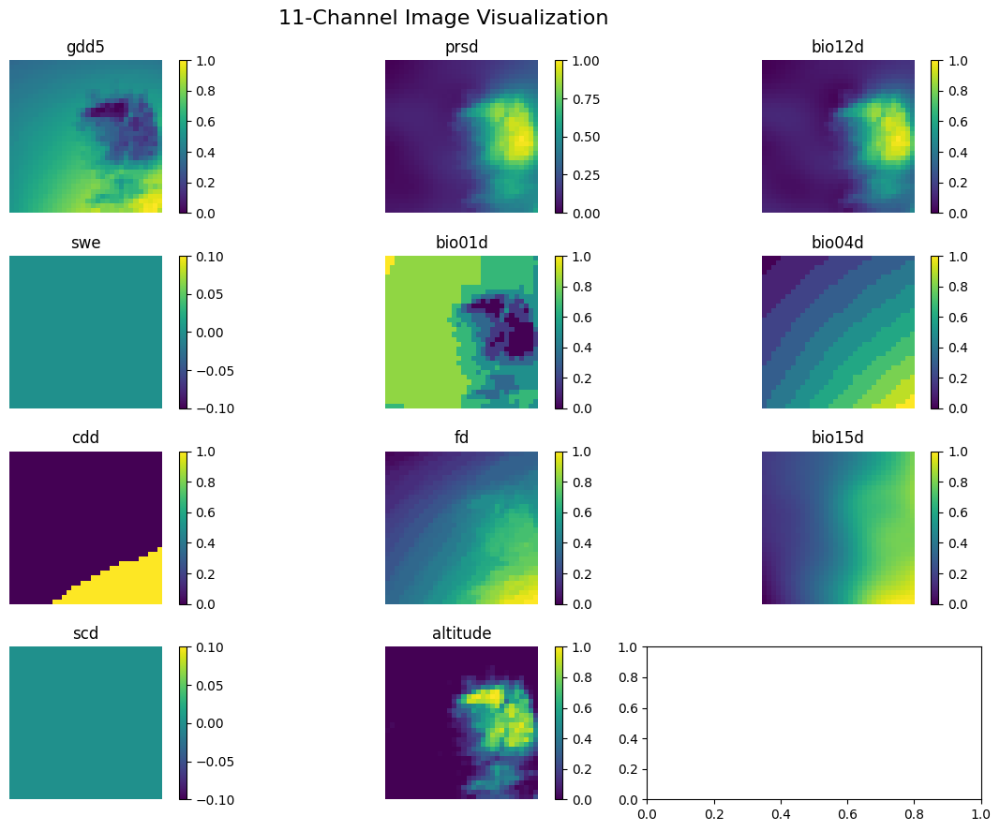

In [84]:
import numpy as np
import matplotlib.pyplot as plt

# Example 10-channel image (Replace with your actual data)
image_10ch = gbif_assemblages_climatic.iloc[44].climatic_map  # Shape (Height, Width, 10)

# Set up a 3-row, 3-column grid for 9 channels
fig, axes = plt.subplots(4,3, figsize=(12, 9))  # Adjust layout for 9 images
fig.suptitle("11-Channel Image Visualization", fontsize=16)

# Create a color map
cmap = plt.get_cmap("viridis")
variable_names = variables
variable_names.append('altitude')
for i in range(11):  # Loop over the first 9 channels
    ax = axes[i // 3, i % 3]  # Position in grid
    img = ax.imshow(image_10ch[:, :, i], cmap=cmap)  # Use a colormap for visualization
    ax.set_title(f"{variables[i]}")
    ax.axis("off")  # Hide axes

    # Add colorbar for each subplot
    fig.colorbar(img, ax=ax, orientation='vertical')
plt.tight_layout()
plt.show()


In [69]:
gbif_assemblages_climatic.iloc[10].climatic_map

array([[[0.49577808, 0.        , 0.        , ..., 0.2013359 ,
         0.        , 0.        ],
        [0.5032854 , 0.00459433, 0.00487208, ..., 0.20097733,
         0.        , 0.        ],
        [0.50578785, 0.00901413, 0.00876474, ..., 0.21201324,
         0.        , 0.        ],
        ...,
        [0.5586481 , 0.29010248, 0.25360394, ..., 0.8983879 ,
         0.        , 0.        ],
        [0.555521  , 0.3089261 , 0.26957655, ..., 0.9465103 ,
         0.        , 0.        ],
        [0.55176735, 0.32756376, 0.2849214 , ..., 1.        ,
         0.        , 0.        ]],

       [[0.50516224, 0.00598407, 0.00567579, ..., 0.21047592,
         0.        , 0.        ],
        [0.5089159 , 0.01061583, 0.01009607, ..., 0.21714401,
         0.        , 0.        ],
        [0.5111046 , 0.01518345, 0.01474214, ..., 0.21959305,
         0.        , 0.        ],
        ...,
        [0.5686588 , 0.29499698, 0.25925446, ..., 0.89076996,
         0.        , 0.        ],
        [0.5

### Loop through all resolutions

In [32]:
import pickle
import json
import ast

In [33]:
# Create binary vectors for each row
def species_to_vector(species_list):
    vector = np.zeros(vector_length, dtype=int)  # Initialize zeros
    for species in species_list:
        if species in species_universe:  # Check if species is in the dictionary
            vector[species_universe[species]] = 1  # Set corresponding position to 1
    return vector

In [34]:
# The computer runs out of memory when running all of them in loop

In [35]:
# # Load from JSON file
# with open(r"Data\species_universe.json", "r") as file:
#     species_universe = json.load(file)
    
# # Define the file paths for each variable (you need to have the full paths for each variable)
# path_altitude = r"C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc"

# variables =['gdd5', 'prsd', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd'] # 'swe', we have removed it bc it has Nan values in many cases
# resolutions = [6,16,32]
# for resolution in resolutions:    
#     stacked_patches_list = []
#     #x = 100
#     for i in range(gbif_assemblages.shape[0]): # x
#         sample =  gbif_assemblages.iloc[i]
#         file_paths = [f"CHELSA\\1991-2020\\chelsav2\\EUR11\\obs\\annual\\V2.1\\{var}\\CHELSA_EUR11_obs_{var}_{sample.year}_V.2.1.nc" for var in variables]
#         file_paths.append(path_altitude)
        
#         # Call the function to get the stacked patches
#         stacked_patches = read_netcdf_stack(file_paths = file_paths, 
#                                             latitude = sample.latitude, 
#                                             longitude = sample.longitude, 
#                                             grid = resolution) # better to use multiples of 64
        
#         stacked_patches_list.append(stacked_patches)
    
#         print(f'Sample {i} correctly stacked and added to the list')
#         print('\n\n')
    
#     gbif_assemblages_climatic = gbif_assemblages#.head(x)
    
#     gbif_assemblages_climatic['species'] = gbif_assemblages_climatic['species'].apply(ast.literal_eval) #ensure all species list are parsed into lists

#     gbif_assemblages_climatic['climatic_map'] = stacked_patches_list
    
#     gbif_assemblages_climatic.to_csv(f'Data\\gbif_assemblages_climatic_1991-2018_{resolution*2}.csv',index = False)
#     # Save DataFrame as a Pickle file
#     with open(f'Data\\gbif_assemblages_climatic_1991-2018_{resolution*2}.pkl', "wb") as file_1:
#         pickle.dump(gbif_assemblages_climatic, file_1)
        
#     vector_length = len(species_universe)

#     # Apply the function to create binary vectors
#     gbif_assemblages_climatic.loc[:, 'species_vector'] = gbif_assemblages_climatic['species'].apply(species_to_vector)   
    
#     gbif_assemblages_climatic.to_csv(f'Data\\vectorized_gbif_assemblages_climatic_1991-2018_{resolution*2}.csv',index=False)

#      # Save DataFrame as a Pickle file
#     with open(f'Data\\vectorized_gbif_assemblages_climatic_1991-2018_{resolution*2}.pkl', "wb") as file_2:
#         pickle.dump(gbif_assemblages_climatic, file_2)

In [ ]:
# Load from JSON file
with open(r"Data\species_universe.json", "r") as file:
    species_universe = json.load(file)
    
# Define the file paths for each variable (you need to have the full paths for each variable)
path_altitude = r"C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc"
#gbif_assemblages_climatic['species'] = gbif_assemblages_climatic['species'].apply(ast.literal_eval) #ensure all species list are parsed into lists esto hay que hacerlo solo una vez y si no da ERROR!!!
variables =['gdd5', 'prsd', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd'] # 'swe', we have removed it bc it has Nan values in many cases
resolution = 32 # resolutions = [8,16,32]
stacked_patches_list = []
#x = 100
for i in range(gbif_assemblages.shape[0]): # x
    sample =  gbif_assemblages.iloc[i]
    file_paths = [f"CHELSA\\1991-2020\\chelsav2\\EUR11\\obs\\annual\\V2.1\\{var}\\CHELSA_EUR11_obs_{var}_{sample.year}_V.2.1.nc" for var in variables]
    file_paths.append(path_altitude)
        
    # Call the function to get the stacked patches
    stacked_patches = read_netcdf_stack(file_paths = file_paths, 
                                            latitude = sample.latitude, 
                                            longitude = sample.longitude, 
                                            grid = resolution) # better to use multiples of 64
        
    stacked_patches_list.append(stacked_patches)
    
    print(f'Sample {i} correctly stacked and added to the list')
    print('\n\n')
    

    


Shape of patch for CHELSA\1991-2020\chelsav2\EUR11\obs\annual\V2.1\gdd5\CHELSA_EUR11_obs_gdd5_2011_V.2.1.nc tas: (1, 64, 64)
Shape of patch for CHELSA\1991-2020\chelsav2\EUR11\obs\annual\V2.1\prsd\CHELSA_EUR11_obs_prsd_2011_V.2.1.nc pr: (1, 64, 64)
Shape of patch for CHELSA\1991-2020\chelsav2\EUR11\obs\annual\V2.1\bio12d\CHELSA_EUR11_obs_bio12d_2011_V.2.1.nc pr: (1, 64, 64)
Shape of patch for CHELSA\1991-2020\chelsav2\EUR11\obs\annual\V2.1\swe\CHELSA_EUR11_obs_swe_2011_V.2.1.nc Band1: (64, 64)
Shape of patch for CHELSA\1991-2020\chelsav2\EUR11\obs\annual\V2.1\bio01d\CHELSA_EUR11_obs_bio01d_2011_V.2.1.nc tas: (1, 64, 64)
Shape of patch for CHELSA\1991-2020\chelsav2\EUR11\obs\annual\V2.1\bio04d\CHELSA_EUR11_obs_bio04d_2011_V.2.1.nc tas: (1, 64, 64)
Shape of patch for CHELSA\1991-2020\chelsav2\EUR11\obs\annual\V2.1\cdd\CHELSA_EUR11_obs_cdd_2011_V.2.1.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 64, 64)
Shape of patch for CHELSA\1991-2020\chelsav2\EUR11\obs\annual\V2.

In [51]:
gbif_assemblages_climatic = gbif_assemblages#.head(x)
    
gbif_assemblages_climatic['species'] = gbif_assemblages_climatic['species'].apply(ast.literal_eval) #ensure all species list are parsed into lists

gbif_assemblages_climatic['climatic_map'] = stacked_patches_list

C:\Users\Raul\AppData\Local\Temp\ipykernel_11024\2963815192.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gbif_assemblages_climatic['climatic_map'] = stacked_patches_list


In [52]:
gbif_assemblages_climatic.to_csv(f'Data\\Full_Scale\\gbif_assemblages_climatic_1991-2018_{resolution*2}.csv',index = False)
# Save DataFrame as a Pickle file
with open(f'Data\\Full_Scale\\gbif_assemblages_climatic_1991-2018_{resolution*2}.pkl', "wb") as file_1:
    pickle.dump(gbif_assemblages_climatic, file_1)
        
vector_length = len(species_universe)

# Apply the function to create binary vectors
gbif_assemblages_climatic.loc[:, 'species_vector'] = gbif_assemblages_climatic['species'].apply(species_to_vector)   
    
gbif_assemblages_climatic.to_csv(f'Data\\Full_Scale\\vectorized_gbif_assemblages_climatic_1991-2018_{resolution*2}.csv',index=False)

# Save DataFrame as a Pickle file
with open(f'Data\\Full_Scale\\vectorized_gbif_assemblages_climatic_1991-2018_{resolution*2}.pkl', "wb") as file_2:
    pickle.dump(gbif_assemblages_climatic, file_2)

In [53]:
len(stacked_patches_list[0])

64

In [54]:
gbif_assemblages_climatic

,grid_index,year,species,longitude,latitude,climatic_map,species_vector
1,79231,2011,"[Angelica archangelica, Dactylorhiza majalis, ...",5.172939,59.201189,"[[[0.6787336, 0.0, 0.0, 0.0, 0.9333291, 0.0, 1...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
2,79231,2012,"[Carex distans, Euphrasia foulaensis, Carex ot...",5.172939,59.201189,"[[[0.80476785, 0.0, 0.0, 0.0, 1.0, 0.09091401,...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
3,79231,2014,"[Lysimachia europaea, Ficaria verna, Juncus ar...",5.172939,59.201189,"[[[0.7865815, 0.0, 0.0, 0.0, 0.8666582, 0.0, 0...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
4,79231,2015,"[Tripolium pannonicum, Centaurium littorale, P...",5.172939,59.201189,"[[[0.9959004, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0....","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
5,79231,2016,"[Lysimachia europaea, Lythrum salicaria, Vacci...",5.172939,59.201189,"[[[0.9338181, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0....","[0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, ..."
...,...,...,...,...,...,...,...
71740,1818627,2012,"[Avenella flexuosa, Lathyrus japonicus, Honcke...",30.835603,69.774990,"[[[0.6037681, 0.4642685, 0.41733158, 0.3684568...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
71741,1818627,2017,"[Luzula spicata, Antennaria dioica, Cochlearia...",30.835603,69.774990,"[[[0.6243384, 0.49100083, 0.41381937, 0.405111...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
71742,1820117,1994,"[Honckenya peploides, Alnus incana, Epilobium ...",30.847255,69.755439,"[[[0.75870955, 0.4376034, 0.30038774, 0.236246...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
71743,1821608,1994,"[Taraxacum spectabile, Astragalus norvegicus, ...",30.865522,69.744514,"[[[0.76729196, 0.41197634, 0.255103, 0.1734373...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, ..."


In [55]:
len(gbif_assemblages_climatic.iloc[0].climatic_map[0]),gbif_assemblages_climatic.iloc[0].climatic_map[0]

(64,
 array([[0.6787336 , 0.        , 0.        , 0.        , 0.9333291 ,
         0.        , 1.        , 0.        , 1.        , 0.        ,
         0.        ],
        [0.6811216 , 0.00357676, 0.00319433, 0.        , 0.9333291 ,
         0.        , 1.        , 0.        , 0.9965372 , 0.        ,
         0.        ],
        [0.68162465, 0.00763071, 0.00681156, 0.        , 0.9333291 ,
         0.        , 1.        , 0.        , 0.9926729 , 0.        ,
         0.        ],
        [0.68149877, 0.01220691, 0.0106039 , 0.        , 0.9333291 ,
         0.        , 1.        , 0.        , 0.99120045, 0.        ,
         0.        ],
        [0.68212724, 0.0169456 , 0.01468796, 0.        , 0.9333291 ,
         0.        , 1.        , 0.        , 0.98815346, 0.        ,
         0.        ],
        [0.68237853, 0.02170229, 0.01868451, 0.        , 0.9333291 ,
         0.        , 1.        , 0.        , 0.9861231 , 0.        ,
         0.        ],
        [0.6828811 , 0.02628183, 0.

In [56]:
gbif_assemblages_climatic.iloc[1]['species_vector'][species_universe['Angelica archangelica']],gbif_assemblages_climatic.iloc[1]['species_vector'][species_universe['Carex distans']]

(0, 1)

In [57]:
species_universe

{'Equisetum telmateia': 0,
 'Polystichum lonchitis': 1,
 'Oxalis pocockiae': 2,
 'Phlomis chrysophylla': 3,
 'Poa compressa': 4,
 'Beckmannia syzigachne': 5,
 'Pseudocydonia sinensis': 6,
 'Pedicularis sylvatica': 7,
 'Taraxacum subhamatum': 8,
 'Galium trifidum': 9,
 'Galium elongatum': 10,
 'Rubus laciniatus': 11,
 'Menispermum dauricum': 12,
 'Festuca ovina': 13,
 'Lathyrus pannonicus': 14,
 'Ornithogalum pyramidale': 15,
 'Primula stricta': 16,
 'Prunus laurocerasus': 17,
 'Gentiana cruciata': 18,
 'Callistemon linearis': 19,
 'Saccharum officinarum': 20,
 'Pedicularis hirsuta': 21,
 'Allium dichlamydeum': 22,
 'Sabal mexicana': 23,
 'Malva parviflora': 24,
 'Stellaria ruscifolia': 25,
 'Sedum sexangulare': 26,
 'Cephalanthera rubra': 27,
 'Hyoscyamus niger': 28,
 'Pyrus pyrifolia': 29,
 'Rodgersia aesculifolia': 30,
 'Glebionis coronaria': 31,
 'Acaena glabra': 32,
 'Geranium magnificum': 33,
 'Anchusa cespitosa': 34,
 'Gagea lutea': 35,
 'Ornithogalum dubium': 36,
 'Asplenium sco

In [64]:

with open("Data\\Full_Scale\\vectorized_gbif_assemblages_climatic_1991-2018_64.pkl", "rb") as file:
    df = pickle.load(file)
df

,grid_index,year,species,longitude,latitude,climatic_map,species_vector
1,79231,2011,"[Angelica archangelica, Dactylorhiza majalis, ...",5.172939,59.201189,"[[[0.6787336, 0.0, 0.0, 0.0, 0.9333291, 0.0, 1...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
2,79231,2012,"[Carex distans, Euphrasia foulaensis, Carex ot...",5.172939,59.201189,"[[[0.80476785, 0.0, 0.0, 0.0, 1.0, 0.09091401,...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
3,79231,2014,"[Lysimachia europaea, Ficaria verna, Juncus ar...",5.172939,59.201189,"[[[0.7865815, 0.0, 0.0, 0.0, 0.8666582, 0.0, 0...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
4,79231,2015,"[Tripolium pannonicum, Centaurium littorale, P...",5.172939,59.201189,"[[[0.9959004, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0....","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
5,79231,2016,"[Lysimachia europaea, Lythrum salicaria, Vacci...",5.172939,59.201189,"[[[0.9338181, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0....","[0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, ..."
...,...,...,...,...,...,...,...
71740,1818627,2012,"[Avenella flexuosa, Lathyrus japonicus, Honcke...",30.835603,69.774990,"[[[0.6037681, 0.4642685, 0.41733158, 0.3684568...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
71741,1818627,2017,"[Luzula spicata, Antennaria dioica, Cochlearia...",30.835603,69.774990,"[[[0.6243384, 0.49100083, 0.41381937, 0.405111...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
71742,1820117,1994,"[Honckenya peploides, Alnus incana, Epilobium ...",30.847255,69.755439,"[[[0.75870955, 0.4376034, 0.30038774, 0.236246...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
71743,1821608,1994,"[Taraxacum spectabile, Astragalus norvegicus, ...",30.865522,69.744514,"[[[0.76729196, 0.41197634, 0.255103, 0.1734373...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, ..."


In [65]:
len(df.iloc[0].climatic_map[0]),df.iloc[0].climatic_map[0]

(64,
 array([[0.6787336 , 0.        , 0.        , 0.        , 0.9333291 ,
         0.        , 1.        , 0.        , 1.        , 0.        ,
         0.        ],
        [0.6811216 , 0.00357676, 0.00319433, 0.        , 0.9333291 ,
         0.        , 1.        , 0.        , 0.9965372 , 0.        ,
         0.        ],
        [0.68162465, 0.00763071, 0.00681156, 0.        , 0.9333291 ,
         0.        , 1.        , 0.        , 0.9926729 , 0.        ,
         0.        ],
        [0.68149877, 0.01220691, 0.0106039 , 0.        , 0.9333291 ,
         0.        , 1.        , 0.        , 0.99120045, 0.        ,
         0.        ],
        [0.68212724, 0.0169456 , 0.01468796, 0.        , 0.9333291 ,
         0.        , 1.        , 0.        , 0.98815346, 0.        ,
         0.        ],
        [0.68237853, 0.02170229, 0.01868451, 0.        , 0.9333291 ,
         0.        , 1.        , 0.        , 0.9861231 , 0.        ,
         0.        ],
        [0.6828811 , 0.02628183, 0.

In [66]:
species_universe['Angelica archangelica'],df.iloc[0]['species_vector'],len(df.iloc[0]['species_vector'])

(3475, array([0, 0, 0, ..., 0, 0, 0]), 5357)

In [67]:
df.iloc[1]['species_vector'][species_universe['Angelica archangelica']],df.iloc[1]['species_vector'][species_universe['Carex distans']]

(0, 1)

In [68]:
for i in df.iloc[1]['species_vector']:
    if i != 0:
        print('a')

a
a
a
a
a
a


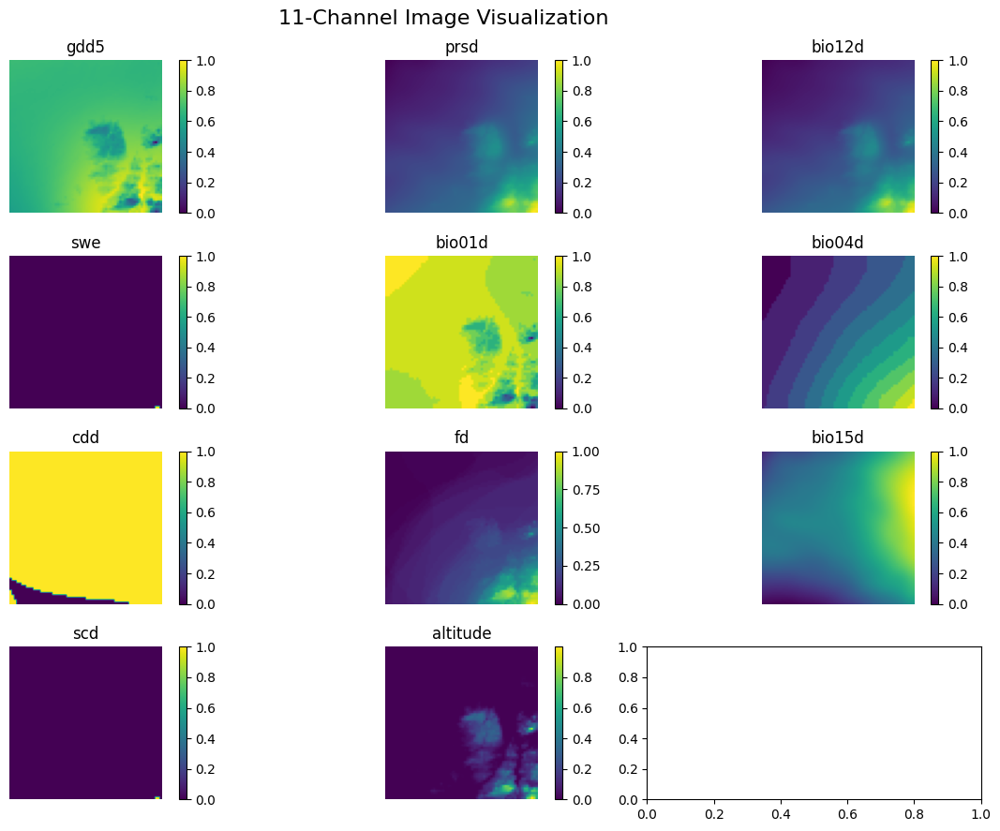

In [69]:
import numpy as np
import matplotlib.pyplot as plt

# Example 10-channel image (Replace with your actual data)
image_10ch = df.iloc[30].climatic_map  # Shape (Height, Width, 10)

# Set up a 3-row, 3-column grid for 9 channels
fig, axes = plt.subplots(4,3, figsize=(12, 9))  # Adjust layout for 9 images
fig.suptitle("11-Channel Image Visualization", fontsize=16)

# Create a color map
cmap = plt.get_cmap("viridis")
variable_names = variables
variable_names.append('altitude')
for i in range(11):  # Loop over the first 9 channels
    ax = axes[i // 3, i % 3]  # Position in grid
    img = ax.imshow(image_10ch[:, :, i], cmap=cmap)  # Use a colormap for visualization
    ax.set_title(f"{variables[i]}")
    ax.axis("off")  # Hide axes

    # Add colorbar for each subplot
    fig.colorbar(img, ax=ax, orientation='vertical')
plt.tight_layout()
plt.show()

### Stacking Tests

In [31]:
def extract_patch(file_path,grid):
    # Open the NetCDF file for the current variable
    data = xr.open_dataset(file_path)

    # Extract variable name (it is always the last variable)
    variable = list(data.data_vars.keys())[-1]

    # Find the closest grid point
    lat_idx = np.argmin(np.abs(data['lat'].values - latitude))
    lon_idx = np.argmin(np.abs(data['lon'].values - longitude))

    # Extract a 10×10 grid patch around the given location
    if 'time' in data.dims:  # If the variable has a time dimension
        patch = data[variable].isel(
            lat=slice(lat_idx - grid, lat_idx + grid),
            lon=slice(lon_idx - grid, lon_idx + grid)
        )
    return patch, patch.values

path_bio15d = f"CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio15d/CHELSA_EUR11_obs_bio15d_2000_V.2.1.nc"

patch_bio15d, patch_values_bio15d = extract_patch(path_bio15d,5)
patch_values_bio15d

path_cdd = f"CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/cdd/CHELSA_EUR11_obs_cdd_2000_V.2.1.nc"

patch_cdd, patch_values_cdd = extract_patch(path_cdd,5)
patch_values_cdd


array([[[0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]]], dtype=float32)

In [46]:
# Stack along a new axis (channel dimension)
stacked = np.stack((patch_values_bio15d, patch_values_cdd), axis=-1)  # Shape will be (2, 2, 3)

print(stacked)


[[[[1.517409  0.       ]
   [1.5242102 0.       ]
   [1.529646  0.       ]
   [1.5339228 0.       ]
   [1.5379182 0.       ]
   [1.5408076 0.       ]
   [1.5429542 0.       ]
   [1.5437044 0.       ]
   [1.5430357 0.       ]
   [1.5411501 0.       ]]

  [[1.5165808 0.       ]
   [1.522617  0.       ]
   [1.5270926 0.       ]
   [1.5306315 0.       ]
   [1.5340323 0.       ]
   [1.5364041 0.       ]
   [1.5380335 0.       ]
   [1.5386919 0.       ]
   [1.538024  0.       ]
   [1.5363181 0.       ]]

  [[1.5150118 0.       ]
   [1.5202619 0.       ]
   [1.523728  0.       ]
   [1.5266107 0.       ]
   [1.5287929 0.       ]
   [1.5306178 0.       ]
   [1.5317837 0.       ]
   [1.5318824 0.       ]
   [1.5313722 0.       ]
   [1.5290873 0.       ]]

  [[1.513228  0.       ]
   [1.5172313 0.       ]
   [1.5202044 0.       ]
   [1.5224459 0.       ]
   [1.5239795 0.       ]
   [1.5250565 0.       ]
   [1.5257722 0.       ]
   [1.5253546 0.       ]
   [1.5242364 0.       ]
   [1.5221795 0.   

In [48]:
print("Shape:", stacked[0].shape)  # Output: (2, 2, 3)

Shape: (10, 10, 2)


In [34]:
import numpy as np

# Define two 2D matrices
A = np.array([[1, 2, 3], 
              [4, 5, 6]])

B = np.array([[7, 8, 9], 
              [10, 11, 12]])

# Stack along a new axis (channel dimension)
stacked = np.stack((A, B), axis=0)  # Shape will be (2, 2, 3)

print(stacked)
print("Shape:", stacked.shape)  # Output: (2, 2, 3)

[[[ 1  2  3]
  [ 4  5  6]]

 [[ 7  8  9]
  [10 11 12]]]
Shape: (2, 2, 3)


### Checking SWE

In [65]:
data_swe = xr.open_dataset("CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/swe/CHELSA_EUR11_obs_swe_2011_V.2.1.nc")
data_swe


<xarray.Dataset> Size: 320MB
Dimensions:  (lat: 6077, lon: 13147)
Coordinates:
  * lat      (lat) float64 49kB 21.97 21.98 21.99 22.0 ... 72.58 72.59 72.6 72.6
  * lon      (lon) float64 105kB -44.64 -44.63 -44.62 -44.61 ... 64.9 64.9 64.91
Data variables:
    crs      |S1 1B ...
    Band1    (lat, lon) float32 320MB ...
Attributes:
    GDAL_AREA_OR_POINT:  Area
    Conventions:         CF-1.5
    GDAL:                GDAL 2.2.3, released 2017/11/20
    history:             Thu Feb 02 16:26:48 2023: GDAL CreateCopy( /storage/...


**Since we got all Nan in this SWE variable shall we remove it or whaaat?**


In [68]:
# Extract variable name (it is always the last variable)
variable = list(data_swe.data_vars.keys())[-1]
grid = 5
latitude = gbif_assemblages_climatic.iloc[0].latitude
longitude = gbif_assemblages_climatic.iloc[0].longitude
# Find the closest grid point
lat_idx = np.argmin(np.abs(data_swe['lat'].values - latitude))
lon_idx = np.argmin(np.abs(data_swe['lon'].values - longitude))
patch = data_swe[variable].isel(
            lat=slice(lat_idx - grid, lat_idx + grid),
            lon=slice(lon_idx - grid, lon_idx + grid)
        )

patch.values

array([[nan, nan, nan, nan, nan, nan, nan, nan, nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan],
       [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan]], dtype=float32)

### Reading images to see stacking

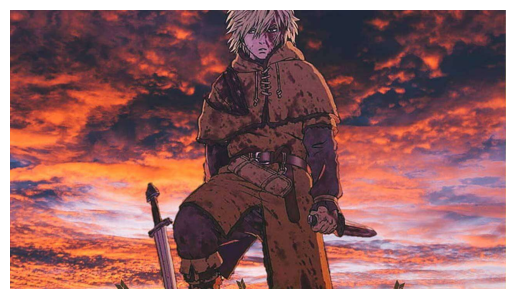

In [35]:
import cv2
# Show the image
# Convert BGR to RGB (since OpenCV loads images in BGR format)
image_rgb = cv2.cvtColor(cv2.imread("/home/raul/Downloads/vinland-saga-2.jpg"), cv2.COLOR_BGR2RGB)

# Display the image
plt.imshow(image_rgb)
plt.axis("off")  # Hide axes
plt.show()

In [36]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt 

# Load image
image = Image.open("/home/raul/Downloads/vinland-saga-2.jpg")

# Convert to NumPy array
image_matrix = np.array(image)

# Print the matrix structure
print("Matrix shape:", image_matrix.shape)
print("Matrix representation:\n", image_matrix)


Matrix shape: (720, 1280, 3)
Matrix representation:
 [[[105  62  72]
  [105  62  72]
  [107  61  72]
  ...
  [ 71  59  61]
  [ 60  48  50]
  [138 126 128]]

 [[108  62  73]
  [108  62  73]
  [108  62  73]
  ...
  [ 70  58  60]
  [ 59  47  51]
  [137 125 127]]

 [[110  63  73]
  [110  63  73]
  [110  63  73]
  ...
  [ 68  57  61]
  [ 57  46  52]
  [134 123 127]]

 ...

 [[209 118  97]
  [212 120  97]
  [214 120  95]
  ...
  [233 204 190]
  [236 205 184]
  [235 208 179]]

 [[239 139 105]
  [244 141 108]
  [246 142 107]
  ...
  [237 205 190]
  [239 207 184]
  [239 210 180]]

 [[247 141 101]
  [250 144 104]
  [255 146 107]
  ...
  [239 206 191]
  [240 208 183]
  [241 210 181]]]


### The images are represented in 720 columns of 1280 rows (pixels) of 3 values (channels RGB)

In [44]:
len(image_matrix)

720

In [37]:
image_matrix[0],len(image_matrix[0])

(array([[105,  62,  72],
        [105,  62,  72],
        [107,  61,  72],
        ...,
        [ 71,  59,  61],
        [ 60,  48,  50],
        [138, 126, 128]], dtype=uint8),
 1280)

In [38]:
image_matrix[1][0],len(image_matrix[0][0])

(array([108,  62,  73], dtype=uint8), 3)

In [39]:
assert patch_values == stacked_patches[0][8], "Matrices are not equal"



NameError: name 'patch_values' is not defined

In [40]:
stacked_patches[0][0]

array([[1453.1523   ,    5.229132 ,    3.4460928,    2.3060138,
           7.350006 ,    6.350006 ,    0.       ,  107.       ,
           1.517409 ,   21.       ],
       [1326.9022   ,    5.483159 ,    3.597377 ,    2.5101244,
           6.75     ,    6.350006 ,    0.       ,  124.       ,
           1.5242102,   24.       ],
       [1281.4521   ,    5.6504536,    3.6939616,    3.4641833,
           6.5500183,    6.350006 ,    0.       ,  138.       ,
           1.529646 ,   57.       ],
       [1286.2023   ,    5.761347 ,    3.7559562,    3.5280447,
           6.5500183,    6.350006 ,    0.       ,  138.       ,
           1.5339228,   58.       ],
       [1297.5522   ,    5.880016 ,    3.8233607,    3.592968 ,
           6.5500183,    6.350006 ,    0.       ,  138.       ,
           1.5379182,   57.       ],
       [1301.8522   ,    6.023842 ,    3.9095354,    3.700288 ,
           6.5500183,    6.350006 ,    0.       ,  138.       ,
           1.5408076,   57.       ],
       [13

In [42]:
len(stacked_patches)

1

In [197]:
len(stacked_patches)

1

In [43]:
stacked_patches.shape # ta mal, tiene que  ser 10x10x10

(1, 10, 10, 10)

In [49]:
stacked_patches

array([[[[1453.1523   ,    5.229132 ,    3.4460928,    2.3060138,
             7.350006 ,    6.350006 ,    0.       ,  107.       ,
             1.517409 ,   21.       ],
         [1326.9022   ,    5.483159 ,    3.597377 ,    2.5101244,
             6.75     ,    6.350006 ,    0.       ,  124.       ,
             1.5242102,   24.       ],
         [1281.4521   ,    5.6504536,    3.6939616,    3.4641833,
             6.5500183,    6.350006 ,    0.       ,  138.       ,
             1.529646 ,   57.       ],
         [1286.2023   ,    5.761347 ,    3.7559562,    3.5280447,
             6.5500183,    6.350006 ,    0.       ,  138.       ,
             1.5339228,   58.       ],
         [1297.5522   ,    5.880016 ,    3.8233607,    3.592968 ,
             6.5500183,    6.350006 ,    0.       ,  138.       ,
             1.5379182,   57.       ],
         [1301.8522   ,    6.023842 ,    3.9095354,    3.700288 ,
             6.5500183,    6.350006 ,    0.       ,  138.       ,
             